## LG SOC Prediction - Convolutional Neural Net (CNN)
LG 18650HG2 Li-ion Battery Data - https://data.mendeley.com/datasets/cp3473x7xv/3

Kollmeyer, Philip; Vidal, Carlos; Naguib, Mina; Skells, Michael  (2020), “LG 18650HG2 Li-ion Battery Data and Example Deep Neural Network xEV SOC Estimator Script”, Mendeley Data, V3, doi: 10.17632/cp3473x7xv.3

In [11]:
import os
import sys
import IPython
import IPython.display
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import collections
from numpy import reshape, array
from datetime import datetime, timedelta

import tensorflow as tf
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Conv1D
from keras.layers.core import Dense
from tensorflow.keras import layers

cell_type = "lg"
model_type = "cnn_model"
base_path = '../../'

sys.path.append(base_path)
from training import utils

panasonic_data_path = base_path + 'datasets/Panasonic_18650PF'
lg_data_path = base_path + 'datasets/LG_18650HG2'
pre_trained_path = base_path + 'pre-trained/' + cell_type + '_' + model_type

resample_1hz = True
vi_averages = True

## LG Test, Train Processing

In [ ]:
lg_charge_cycles = ['Charge']

lg_train_temps = ['n10degC', '0degC', '10degC', '25degC']
lg_train_discharge_cycles = ['Mixed']

lg_test_temps = ['n10degC', '0degC', '10degC', '25degC']
lg_test_discharge_cycles = ['UDDS', 'HWFET', 'LA92', 'US06']

lg_train_files = utils.lg_get_files(lg_data_path, 
                                    lg_train_discharge_cycles, 
                                    lg_charge_cycles, 
                                    lg_train_temps)

lg_test_files = utils.lg_get_files(lg_data_path, 
                                   lg_test_discharge_cycles,
                                   lg_charge_cycles, 
                                   lg_test_temps)

lg_train, lg_train_norm = utils.lg_create_dataset(lg_train_files, 
                                                  lg_train_discharge_cycles, 
                                                  lg_charge_cycles, 
                                                  vi_averages, 
                                                  resample_1hz)

lg_test, lg_test_norm = utils.lg_create_dataset(lg_test_files, 
                                                lg_test_discharge_cycles, 
                                                lg_charge_cycles, 
                                                vi_averages, 
                                                resample_1hz)

## LG Train, Test Stats

In [26]:
lg_train.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Time Stamp,,,,,,,,
Voltage,176334.0,3.665063,0.262172,2.792680,3.494900,3.672220,3.859490,4.200630
Current,176334.0,-1.333758,2.561152,-17.822440,-2.556640,-0.950120,-0.097060,5.999610
Temperature,176334.0,7.891981,12.526156,-9.884900,-0.315480,9.359110,23.976150,26.289630
Power,176334.0,-4.596105,8.941956,-50.862673,-9.210683,-3.477834,-0.386161,25.171220
Capacity,176334.0,0.485778,0.267832,0.000000,0.269070,0.473796,0.715691,0.978056
Voltage Average,176334.0,3.699654,0.226606,3.094354,3.521361,3.694212,3.889611,4.139058
Current Average,176334.0,-1.296481,0.711963,-3.715850,-1.720026,-1.162827,-0.772447,-0.277316
Power Average,176334.0,-4.522300,2.410210,-11.429077,-5.996818,-4.127167,-2.722423,-1.079428


In [27]:
lg_test.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Time Stamp,,,,,,,,
Voltage,104485.0,3.677951,0.261341,2.794030,3.496920,3.689080,3.885750,4.200120
Current,104485.0,-1.098654,2.357463,-17.610450,-2.191410,-0.625750,-0.084280,5.999610
Temperature,104485.0,6.921388,12.063139,-10.095220,-0.420630,9.148790,23.765830,26.815430
Power,104485.0,-3.776420,8.243404,-50.864924,-7.916661,-2.317480,-0.316026,25.142453
Capacity,104485.0,0.484375,0.267702,0.000000,0.258278,0.494788,0.714165,0.955909
Voltage Average,104485.0,3.704737,0.229296,3.049658,3.523629,3.716103,3.900654,4.110299
Current Average,104485.0,-1.097331,0.728330,-3.810095,-1.335683,-0.867386,-0.523847,-0.311306
Power Average,104485.0,-3.824287,2.439860,-11.887300,-4.544482,-3.073238,-1.888219,-1.210706


## LG Dataset Figures, Distribution

In [ ]:
plot_cols = ['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Capacity']

fig, axs = plt.subplots(nrows=len(plot_cols), ncols=2, figsize=(15, 25))

for i, col in enumerate(plot_cols):
    axs[i, 0].plot(lg_train[col], label='LG')
    axs[i, 0].set_title(f'LG {col} - Train, 1Hz')
    axs[i, 0].legend()
    
    axs[i, 1].plot(lg_test[col], label='LG', color="green")
    axs[i, 1].set_title(f'LG {col} - Test, 1Hz')
    axs[i, 1].legend()

In [ ]:
df_std = lg_train.melt(var_name='Column', value_name='No Normalization')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='No Normalization', data=df_std)
_ = ax.set_xticklabels(lg_train.keys(), rotation=90)
_ = ax.set_title(label='LG Train Data Distribution, No Normalization')

In [ ]:
df_std = lg_train_norm.melt(var_name='Column', value_name='Normalized')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='Normalized', data=df_std)
_ = ax.set_xticklabels(lg_train_norm.keys(), rotation=90)
_ = ax.set_title(label='LG Train Data Distribution, Normalized')

In [ ]:
ax = sns.pairplot(lg_train_norm[['Voltage', 'Current', 'Power', 'Temperature', 'Capacity']], diag_kind='kde')
ax.fig.suptitle("Pair Plot, LG Training Dataset", y = 1.01) 

## CNN MODEL TRAINING

In [3]:
train_features = lg_train_norm
test_features = lg_test_norm

train_labels = train_features.pop('Capacity')
test_labels = test_features.pop('Capacity')

In [5]:
# reshape for CNN 1-D
train_array = array(train_features)
labels_array = array(train_labels)

sample_size = train_features.shape[0]
time_steps = train_features.shape[1]
input_dimension = 1

train_reshaped = train_array.reshape((sample_size,time_steps,1))
labels_reshaped = labels_array.reshape((train_labels.shape[0],1,1))

print(train_reshaped.shape)
print(labels_reshaped.shape)

(176334, 7, 1)
(176334, 1, 1)


In [12]:
# cnn model definition
cnn_model = Sequential()
cnn_model.add(Conv1D(filters=32,
                     kernel_size=(train_features.shape[1],),
                     activation='relu'))
cnn_model.add(Dense(32, activation='relu'))
cnn_model.add(Dense(1))

cnn_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss='mean_absolute_error')

In [14]:
%%time
history = cnn_model.fit(
    train_reshaped, 
    train_labels,             
    epochs=25, batch_size=32, 
    verbose=1, validation_split=0.2)

Epoch 1/25
4409/4409 [==============================] - 17s 4ms/step - loss: 0.0077 - val_loss: 0.0202
Epoch 2/25
4409/4409 [==============================] - 24s 5ms/step - loss: 0.0076 - val_loss: 0.0193
Epoch 3/25
4409/4409 [==============================] - 16s 4ms/step - loss: 0.0076 - val_loss: 0.0193
Epoch 4/25
4409/4409 [==============================] - 23s 5ms/step - loss: 0.0075 - val_loss: 0.0208
Epoch 5/25
4409/4409 [==============================] - 21s 5ms/step - loss: 0.0075 - val_loss: 0.0215
Epoch 6/25
4409/4409 [==============================] - 23s 5ms/step - loss: 0.0075 - val_loss: 0.0193
Epoch 7/25
4409/4409 [==============================] - 27s 6ms/step - loss: 0.0074 - val_loss: 0.0203
Epoch 8/25
4409/4409 [==============================] - 27s 6ms/step - loss: 0.0074 - val_loss: 0.0200
Epoch 9/25
4409/4409 [==============================] - 18s 4ms/step - loss: 0.0074 - val_loss: 0.0195
Epoch 10/25
4409/4409 [==============================] - 24s 5ms/step - l

## SAVE MODEL, EVALUATE

In [15]:
cnn_model.save(pre_trained_path)

# load pre-trained model
# model = tf.keras.models.load_model(pre_trained_path)

INFO:tensorflow:Assets written to: ../../pre-trained/lg_cnn_model/assets


INFO:tensorflow:Assets written to: ../../pre-trained/lg_cnn_model/assets


In [16]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,val_loss,epoch
20,0.007085,0.019792,20
21,0.007066,0.022519,21
22,0.007129,0.022153,22
23,0.007071,0.026862,23
24,0.007083,0.019949,24


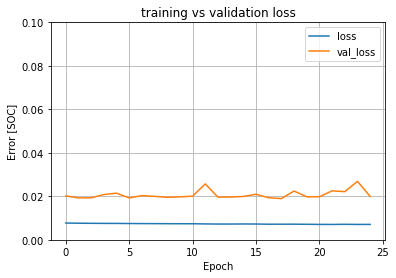

In [20]:
def plot_loss(history):
    plt.plot(history.history['loss'], label='loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.ylim([0, 0.1])
    plt.xlabel('Epoch') 
    plt.ylabel('Error [SOC]')
    plt.title('training vs validation loss')
    plt.legend()
    plt.grid(True)
    
plot_loss(history)

3266/3266 - 9s - loss: 0.0247 - 9s/epoch - 3ms/step
3266/3266 [==============================] - 9s 3ms/step


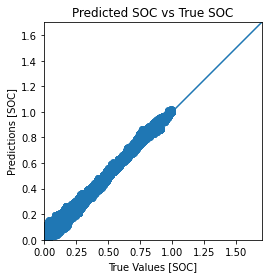

In [21]:
test_results = cnn_model.evaluate(test_features, test_labels, verbose=2)
test_predictions = cnn_model.predict(test_features).flatten()

a = plt.axes(aspect='equal')
plt.scatter(test_labels, test_predictions)
plt.xlabel('True Values [SOC]')
plt.ylabel('Predictions [SOC]')
lims = [0, 1.7]
plt.xlim(lims)
plt.ylim(lims)
plt.title('Predicted SOC vs True SOC')
_ = plt.plot(lims, lims)

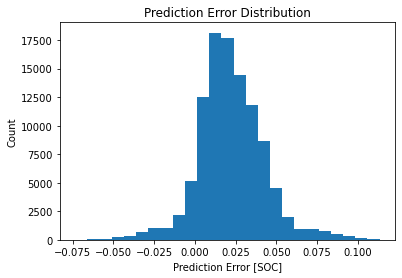

In [22]:
error = test_predictions - test_labels
plt.hist(error, bins=25)
plt.xlabel('Prediction Error [SOC]')
plt.title('Prediction Error Distribution')
_ = plt.ylabel('Count')

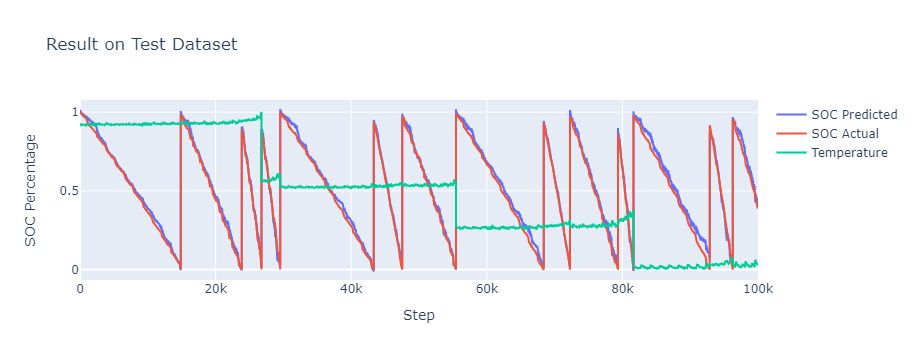

In [25]:
import plotly.graph_objects as go

cycle_num = 0
steps_num = 100000
step_index = np.arange(cycle_num*steps_num, (cycle_num+1)*steps_num)

fig = go.Figure()
fig.add_trace(go.Scatter(x=step_index, y=test_predictions[cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='SOC Predicted'))
fig.add_trace(go.Scatter(x=step_index, y=test_labels[cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='SOC Actual'))
fig.add_trace(go.Scatter(x=step_index, y=lg_test_norm['Temperature'][cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='Temperature'))
fig.update_layout(title='Result on Test Dataset',
                  xaxis_title='Step',
                  yaxis_title='SOC Percentage')
fig.show()